## Read vehicles and non-vehicles data

In [1]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
import cv2
import time
from skimage.feature import hog as skhog
from sklearn.svm import LinearSVC
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

In [2]:
import os
import glob
basedir = './vehicles/'
image_sources = os.listdir(basedir)
car_images = []
for s in (image_sources):
    car_images.extend(glob.glob(basedir + s + '/*'))
    
print('No of cars images: %d' % len(car_images))
with open('cars.txt', 'w') as f:
    for i in car_images:
        f.write(i + '\n')
        
basedir = './non-vehicles/'
non_image_sources = os.listdir(basedir)
not_car_images = []
for s in (non_image_sources):
    not_car_images.extend(glob.glob(basedir + s + '/*'))
    
print('No of non-cars images: %d' % len(not_car_images))
with open('not-cars.txt', 'w') as f:
    for i in not_car_images:
        f.write(i + '\n')        



No of cars images: 8792
No of non-cars images: 8968


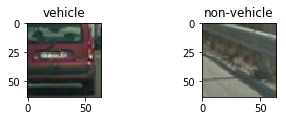

In [156]:
## Examples 
vehicle_image = mpimg.imread(car_images[np.random.randint(0, len(car_images))])
not_vehicle_image = mpimg.imread(not_car_images[np.random.randint(0, len(not_car_images))])
fig =plt.figure(figsize=(12,3))
fig.tight_layout()
visualize_figure(fig, 2,4, [vehicle_image, not_vehicle_image],['vehicle', 'non-vehicle'])

## Extracting features

In [3]:

def get_hog_features(img, orient, pix_per_cell, cell_per_block, vis=False, feature_vec=True):
    # Call with two outputs if vis==True
    if vis == True:
        features, hog_image = skhog(img, orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell),
                                  cells_per_block=(cell_per_block, cell_per_block), block_norm= 'L2-Hys',
                                  transform_sqrt=True, 
                                  visualise=vis,
                                  feature_vector=feature_vec)
        return features, hog_image
    # Otherwise call with one output
    else:      
        features = skhog(img, orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell),
                       cells_per_block=(cell_per_block, cell_per_block), block_norm= 'L2-Hys',
                       transform_sqrt=True, visualise=vis, feature_vector=feature_vec)
        return features

def bin_spatial(img, size=(32, 32)):
    color1 = cv2.resize(img[:,:,0], size).ravel()
    color2 = cv2.resize(img[:,:,1], size).ravel()
    color3 = cv2.resize(img[:,:,2], size).ravel()
    # Use cv2.resize().ravel() to create the feature vector
    # Return the feature vector
    return np.hstack((color1, color2, color3))
    

# Define a function to compute color histogram features  
def color_hist(img, nbins=32) : #, bins_range=(0, 256)):
    # Compute the histogram of the color channels separately
    channel1_hist = np.histogram(img[:,:,0], bins=nbins)#, range=bins_range)
    channel2_hist = np.histogram(img[:,:,1], bins=nbins)
    channel3_hist = np.histogram(img[:,:,2], bins=nbins)
    # Concatenate the histograms into a single feature vector
    hist_features = np.concatenate((channel1_hist[0], channel2_hist[0], channel3_hist[0]))
    # Return the individual histograms, bin_centers and feature vector
    return hist_features




In [4]:


# Define a function to extract features from a list of images
# Have this function call bin_spatial() and color_hist()


def extract_features(imgs, color_space='RGB', spatial_size=(32,32),
                        hist_bins = 32,
                        orient=9, 
                        pix_per_cell=8, cell_per_block=2, hog_channel=0,
                        spatial = True, hist = True, hog = True):
    # Create a list to append feature vectors to
    features = []
    # Iterate through the list of images
    for file in imgs:
        # Read in each one by one
        image = mpimg.imread(file)
        filefeatures = []
        # apply color conversion if other than 'RGB'
        if color_space != 'RGB':
            if color_space == 'HSV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
            elif color_space == 'LUV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
            elif color_space == 'HLS':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
            elif color_space == 'YUV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2YUV)
            elif color_space == 'YCrCb':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2YCrCb)
        else: feature_image = np.copy(image)      
        if spatial == True:
            spatial_features = bin_spatial(feature_image, size=spatial_size)
            #4) Append features to list
            filefeatures.append(spatial_features)
    #5) Compute histogram features if flag is set
        if hist == True:
            hist_features = color_hist(feature_image, nbins=hist_bins)
            #6) Append features to list
            filefeatures.append(hist_features)
        # Call get_hog_features() with vis=False, feature_vec=True
        if hog_channel == 'ALL':
            hog_features = []
            for channel in range(feature_image.shape[2]):
                hog_features.append(get_hog_features(feature_image[:,:,channel], 
                                    orient, pix_per_cell, cell_per_block, 
                                    vis=False, feature_vec=True))
            hog_features = np.ravel(hog_features)        
        else:
            hog_features = get_hog_features(feature_image[:,:,hog_channel], orient, 
                        pix_per_cell, cell_per_block, vis=False, feature_vec=True)
        # Append the new feature vector to the features list
        filefeatures.append(hog_features)
        features.append(np.concatenate(filefeatures))
    # Return list of feature vectors
    return features

### Defining sliding windows
def slide_window(img, x_start_stop=[None, None], y_start_stop=[None, None], 
                    xy_window=(64, 64), xy_overlap=(0.5, 0.5)):
    # If x and/or y start/stop positions not defined, set to image size
    if x_start_stop[0] == None:
        x_start_stop[0] = 0
    if x_start_stop[1] == None:
        x_start_stop[1] = img.shape[1]
    if y_start_stop[0] == None:
        y_start_stop[0] = 0
    if y_start_stop[1] == None:
        y_start_stop[1] = img.shape[0]
    # Compute the span of the region to be searched    
    xspan = x_start_stop[1] - x_start_stop[0]
    yspan = y_start_stop[1] - y_start_stop[0]
    # Compute the number of pixels per step in x/y
    nx_pix_per_step = np.int(xy_window[0]*(1 - xy_overlap[0]))
    ny_pix_per_step = np.int(xy_window[1]*(1 - xy_overlap[1]))
    # Compute the number of windows in x/y
    nx_buffer = np.int(xy_window[0]*(xy_overlap[0]))
    ny_buffer = np.int(xy_window[1]*(xy_overlap[1]))
    ## compute number of windows 
    nx_windows = np.int((xspan-nx_buffer)/nx_pix_per_step) - 1
    ny_windows = np.int((yspan-ny_buffer)/ny_pix_per_step) - 1
    window_list = []
    for ys in range(ny_windows):
        for xs in range(nx_windows):
            # Calculate window position
            startx = xs*nx_pix_per_step + x_start_stop[0]
            endx = startx + xy_window[0]
            starty = ys*ny_pix_per_step + y_start_stop[0]
            endy = starty + xy_window[1]
            # Append window position to list
            window_list.append(((startx, starty), (endx, endy)))
    # Return the list of windows
    return window_list

def draw_boxes(img, bboxes, color=(0, 0, 255), thick=6):
    # Make a copy of the image
    imcopy = np.copy(img)
    # Iterate through the bounding boxes
    for bbox in bboxes:
        # Draw a rectangle given bbox coordinates
        cv2.rectangle(imcopy, bbox[0], bbox[1], color, thick)
    # Return the image copy with boxes drawn
    return imcopy



def single_img_features(img, color_space='RGB', spatial_size=(32, 32),
                        hist_bins=32, orient=9, 
                        pix_per_cell=8, cell_per_block=2, hog_channel=0,
                        spatial_feat=True, hist_feat=True, hog_feat=True):    
    #1) Define an empty list to receive features
    img_features = []
    #2) Apply color conversion if other than 'RGB'
    if color_space != 'RGB':
        if color_space == 'HSV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
        elif color_space == 'LUV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2LUV)
        elif color_space == 'HLS':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
        elif color_space == 'YUV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2YUV)
        elif color_space == 'YCrCb':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2YCrCb)
    else: feature_image = np.copy(img)      
    #3) Compute spatial features if flag is set
    if spatial_feat == True:
        spatial_features = bin_spatial(feature_image, size=spatial_size)
        #4) Append features to list
        img_features.append(spatial_features)
    #5) Compute histogram features if flag is set
    if hist_feat == True:
        hist_features = color_hist(feature_image, nbins=hist_bins)
        #6) Append features to list
        img_features.append(hist_features)
    #7) Compute HOG features if flag is set
    if hog_feat == True:
        if hog_channel == 'ALL':
            hog_features = []
            for channel in range(feature_image.shape[2]):
                hog_features.extend(get_hog_features(feature_image[:,:,channel], 
                                    orient, pix_per_cell, cell_per_block, 
                                    vis=False, feature_vec=True))      
        else:
            hog_features = get_hog_features(feature_image[:,:,hog_channel], orient, 
                        pix_per_cell, cell_per_block, vis=False, feature_vec=True)
        #8) Append features to list
        img_features.append(hog_features)

    #9) Return concatenated array of features
    return np.concatenate(img_features)

## Find the right windows

In [5]:
def search_windows(image, windows, classifier, scaler, color_space = 'RGB', spatial_size = (32,32),
                    hist_bins = 64, hist_range = (0, 256), orient = 9,
                    pixel_per_cell = 8, cell_per_block = 2,
                    hog_channel = 0, spatial = True, hist = True, hog = True):
    result_windows = []
    for w in windows :
        test_img = cv2.resize((image[w[0][1]:w[1][1], w[0][0]:w[1][0]]), (64,64))
        features =  single_img_features(test_img, color_space= color_space,
                                               spatial_size = spatial_size, hist_bins= hist_bins,
                                               orient = orient, pix_per_cell = pix_per_cell,
                                               cell_per_block = cell_per_block,
                                               hog_channel = hog_channel, spatial_feat=spatial, hist_feat=hist, hog_feat=hog)
        #print('FEATURES: ', features.shape)
        #print('Color: ', color_space, 'sparial: ', spatial_size,'hist: ', hist_bins, orient, pix_per_cell,cell_per_block, hog_channel, spatial, hist, hog)
        ## rescale using scaler
        scaled_features =scaler.transform(np.array(features).reshape(1, -1))
        #6) Predict using your classifier
        prediction = classifier.predict(scaled_features)
        #7) If positive (prediction == 1) then save the window
        if prediction == 1:
            result_windows.append(w)
    return result_windows


def draw_labeled_boxes(img, labels):
    # Iterate through all detected cars
    for car_number in range(1, labels[1]+1):
        # Find pixels with each car_number label value
        nonzero = (labels[0] == car_number).nonzero()
        # Identify x and y values of those pixels
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Define a bounding box based on min/max x and y
        bbox = ((np.min(nonzerox), np.min(nonzeroy)), (np.max(nonzerox), np.max(nonzeroy)))
        # Draw the box on the image
        cv2.rectangle(img, bbox[0], bbox[1], (0,0,255), 6)
    # Return the image
    return img

## HOG Features

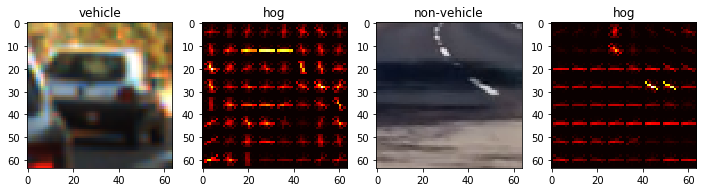

In [144]:
%matplotlib inline
import matplotlib.pyplot as plt
#from matplotlib.pyplot import subplot as sb
## plots multiple images
def visualize_figure(fig, rows, cols, imgs, titles):
    for i, img in enumerate(imgs):
        plt.subplot(rows, cols, i+1)
        plt.title(i+1)
        img_dims = len(img.shape)
        if img_dims < 3:
            plt.imshow(img, cmap = 'hot')
            plt.title(titles[i])
        else:
            plt.imshow(img)
            plt.title(titles[i])

####CONSTANTS
color_space= 'HSV'#'RGB'
orient = 9
pix_per_cell = 8
cell_per_block = 2
hog_channel = 0#'ALL'
spatial_size = (16,16)
hist_bins = 16
spatial = True
hist = True
hog = True

vehicle_image = mpimg.imread(car_images[np.random.randint(0, len(car_images))])
not_vehicle_image = mpimg.imread(not_car_images[np.random.randint(0, len(not_car_images))])
vehicle_hog_features, vehicle_hog_image = get_hog_features(vehicle_image[:,:,hog_channel], 
                                    orient, pix_per_cell, cell_per_block, 
                                    vis=True, feature_vec=True)#, vis = True)
not_vehicle_features, not_vehicle_hog_image = get_hog_features(not_vehicle_image[:,:,hog_channel], 
                                    orient, pix_per_cell, cell_per_block, 
                                    vis=True, feature_vec=True)#, vis = True)
fig =plt.figure(figsize=(12,3))
visualize_figure(fig, 1,4, [vehicle_image, vehicle_hog_image, not_vehicle_image, not_vehicle_hog_image],['vehicle', 'hog', 'non-vehicle', 'hog'])

## Generating features and scaling them

In [7]:
####CONSTANTS
color_space= 'YCrCb'#'RGB''LUV'HLS YUV YCrCb'
orient = 9
pix_per_cell = 8
cell_per_block = 2
hog_channel = 'ALL'
spatial_size = (32,32)
hist_bins = 32
spatial = True
hist = True
hog = True



start = time.time()

## Build classifier
car_features= extract_features(car_images, color_space= color_space, spatial_size=spatial_size,
                        hist_bins=hist_bins, orient=orient, 
                        pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, hog_channel=hog_channel,
                        spatial=spatial, hist=hist, hog=hog)

not_car_features =  extract_features(not_car_images, color_space= color_space, spatial_size=spatial_size,
                        hist_bins=hist_bins, orient=orient, 
                        pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, hog_channel=hog_channel,
                        spatial=spatial, hist=hist, hog=hog)
X = np.vstack((car_features, not_car_features)).astype(np.float64)
##fit to a scaler
y = np.hstack((np.ones(len(car_features)), np.zeros(len(not_car_features))))
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.1, random_state = np.random.randint(0,100))
scaler = StandardScaler().fit(X_train)
#scaled

X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)


##split totest & train data

print(round(time.time() - start, 3)/60 , ' minutes to generate features')
print('Feature vector size: %s' % str(len(X_train[0])))


/Users/q418046/anaconda3/envs/carnd-term1/lib/python3.5/site-packages/skimage/feature/_hog.py:248: skimage_deprecation: Argument `visualise` is deprecated and will be changed to `visualize` in v0.16
  'be changed to `visualize` in v0.16', skimage_deprecation)


3.2649166666666667  minutes to generate features
Feature vector size: 8460


In [8]:
X_train.shape
len(car_features)

8792

## Training SVM and calculating accuracy

In [9]:
#use linear SVM
svc = LinearSVC()
start = time.time()
svc.fit(X_train, y_train)
print(round(time.time() - start, 3), 'seconds for SVC to fit')
print('Accuracy: ', str(round(svc.score(X_test, y_test), 3)))
X_train.shape

10.194 seconds for SVC to fit
Accuracy:  0.992


(15984, 8460)

In [10]:
search_path = 'test_images/*'
example_images = glob.glob(search_path)

extraxt: (1531476,)


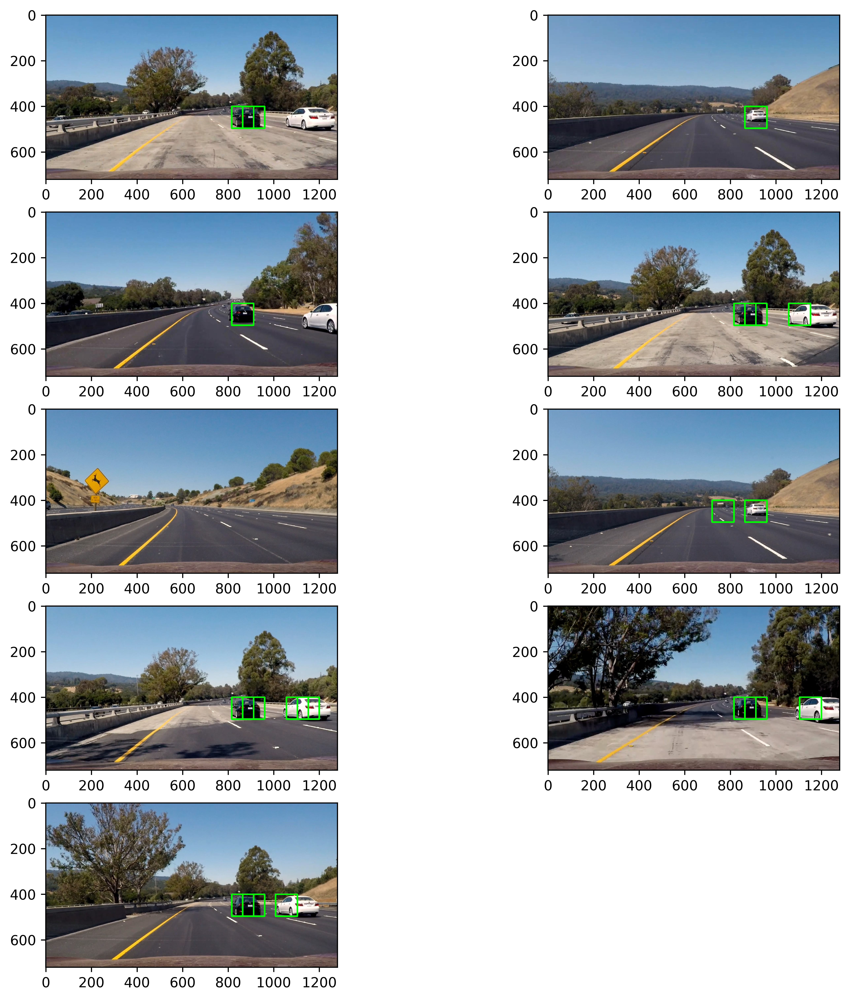

In [138]:

images = []
titles = []
y_start_stop = [400, 656]
overlap = 0.5

features = extract_features(['test_images/test1.jpg'], color_space= color_space, spatial_size=spatial_size,
                        hist_bins=hist_bins, orient=orient, 
                        pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, hog_channel=hog_channel,
                        spatial=spatial, hist=hist, hog=hog)
print('extraxt:', features[0].shape )

for f in example_images:
    image = mpimg.imread(f)  
    copy = np.copy(image)
    img = copy.astype(np.float32)/255 ##read as jpeg
    features = single_img_features(img, color_space= color_space, spatial_size=spatial_size,
                        hist_bins=hist_bins, orient=orient, 
                        pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, hog_channel=hog_channel,
                        spatial_feat=spatial, hist_feat=hist, hog_feat=hog)
    #print('features: ', np.array(features).reshape(1, -1).shape)
    windows = slide_window(img, x_start_stop = [None, None], y_start_stop = y_start_stop, xy_window = (96, 96), xy_overlap = (overlap, overlap))
    hot_windows = search_windows(img, windows, svc, scaler, color_space = color_space, 
                                               spatial_size = spatial_size, hist_bins= hist_bins,
                                               orient = orient, pixel_per_cell = pix_per_cell,
                                               cell_per_block = cell_per_block,
                                               hog_channel = hog_channel, spatial=spatial, hist=hist, hog=hog)
   
    window_img = draw_boxes(copy, hot_windows, color = (0,255,0), thick = 6)
    images.append(window_img)
    titles.append("")
    
%matplotlib inline
fig = plt.figure(figsize = (12,18), dpi = 600)
visualize_figure(fig, 7, 2, images, titles)

/Users/q418046/anaconda3/envs/carnd-term1/lib/python3.5/site-packages/skimage/feature/_hog.py:248: skimage_deprecation: Argument `visualise` is deprecated and will be changed to `visualize` in v0.16
  'be changed to `visualize` in v0.16', skimage_deprecation)


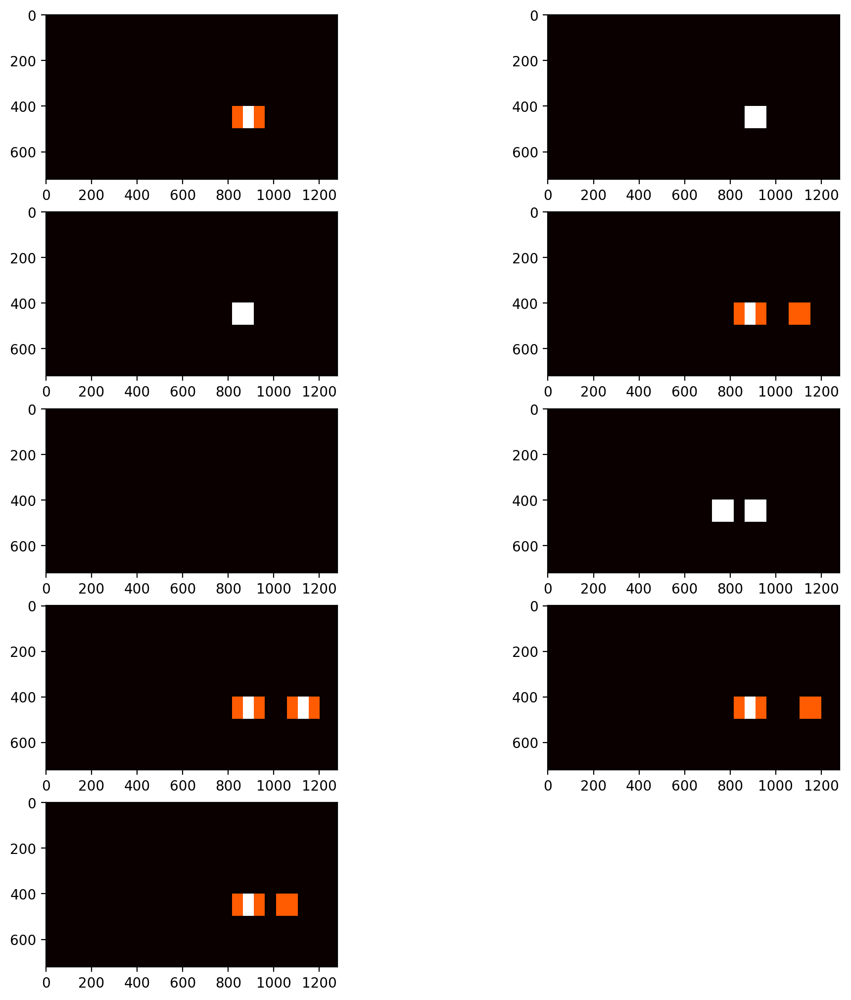

In [12]:
def add_heat(heatmap, bbox_list):
    # Iterate through list of bboxes
    for box in bbox_list:
        # Add += 1 for all pixels inside each bbox
        # Assuming each "box" takes the form ((x1, y1), (x2, y2))
        heatmap[box[0][1]:box[1][1], box[0][0]:box[1][0]] += 1

    # Return updated heatmap
    return heatmap

def apply_threshold(heatmap, threshold):
    # Zero out pixels below the threshold
    heatmap[heatmap <= threshold] = 0
    # Return thresholded map
    return heatmap

heatmaps = []
heat_titles = []
for f in example_images:
    image = mpimg.imread(f)  
    copy = np.copy(image)
    img = copy.astype(np.float32)/255 ##read as jpeg
    features = single_img_features(img, color_space= color_space, spatial_size=spatial_size,
                        hist_bins=hist_bins, orient=orient, 
                        pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, hog_channel=hog_channel,
                        spatial_feat=spatial, hist_feat=hist, hog_feat=hog)
    #print('features: ', np.array(features).reshape(1, -1).shape)
    windows = slide_window(img, x_start_stop = [None, None], y_start_stop = y_start_stop, xy_window = (96, 96), xy_overlap = (overlap, overlap))
    hot_windows = search_windows(img, windows, svc, scaler, color_space = color_space, 
                                               spatial_size = spatial_size, hist_bins= hist_bins,
                                               orient = orient, pixel_per_cell = pix_per_cell,
                                               cell_per_block = cell_per_block,
                                               hog_channel = hog_channel, spatial=spatial, hist=hist, hog=hog)
    heatmap = np.zeros_like(img[:,:,0])
    heatmap = add_heat(heatmap, hot_windows)
    window_img = draw_boxes(copy, hot_windows, color = (0,255,0), thick = 6)
    heatmaps.append(heatmap)
    heat_titles.append("")
    
fig = plt.figure(figsize = (12,18), dpi = 200)
fig.tight_layout()
visualize_figure(fig, 7, 2, heatmaps, heat_titles)

/Users/q418046/anaconda3/envs/carnd-term1/lib/python3.5/site-packages/skimage/feature/_hog.py:248: skimage_deprecation: Argument `visualise` is deprecated and will be changed to `visualize` in v0.16
  'be changed to `visualize` in v0.16', skimage_deprecation)


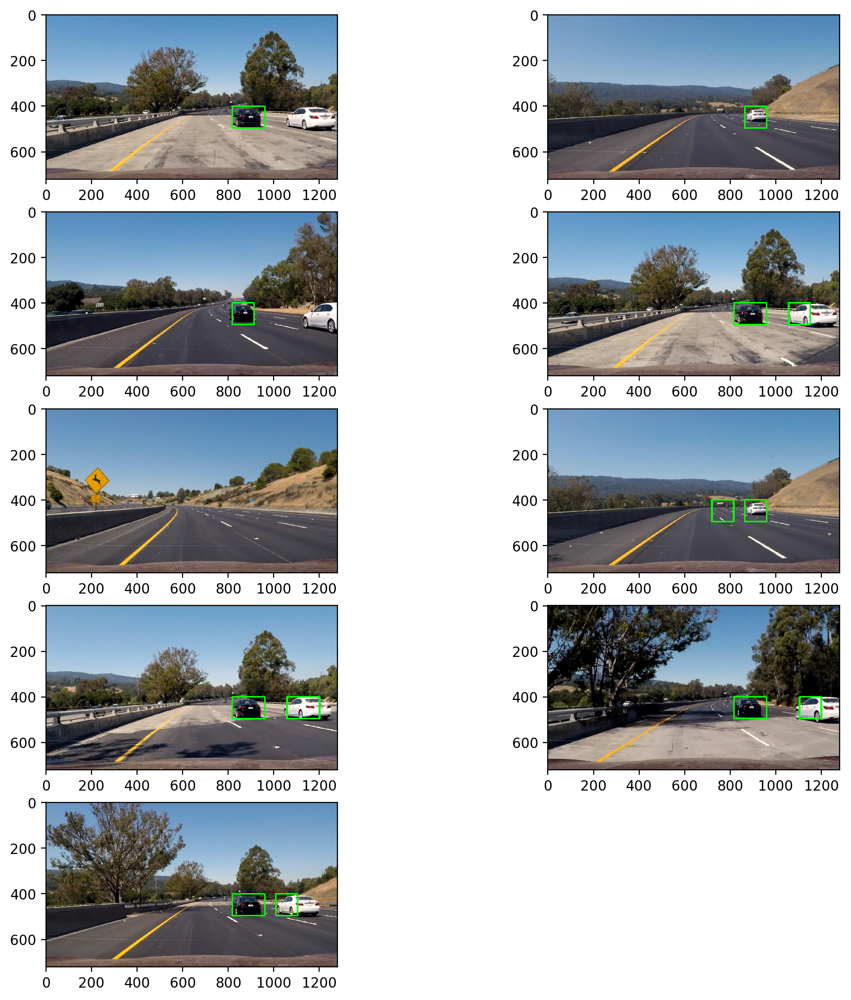

In [13]:
from scipy.ndimage.measurements import label
def draw_labeled_boxes(img, labels):
    for car in range(1, labels[1] + 1):
        #find nonzero region
        nonzero = (labels[0] == car).nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        bound_b = ((np.min(nonzerox), np.min(nonzeroy)),(np.max(nonzerox), np.max(nonzeroy)))
        cv2.rectangle(img, bound_b[0], bound_b[1], (0,255,0),6)
    return img


def get_decorated(image, y_start_stop):
    copy = np.copy(image)
    img = copy.astype(np.float32)/255 ##read as jpeg
    features = single_img_features(img, color_space= color_space, spatial_size=spatial_size,
                        hist_bins=hist_bins, orient=orient, 
                        pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, hog_channel=hog_channel,
                        spatial_feat=spatial, hist_feat=hist, hog_feat=hog)
    #print('features: ', np.array(features).reshape(1, -1).shape)
    windows = slide_window(img, x_start_stop = [None, None], y_start_stop = y_start_stop, xy_window = (96, 96), xy_overlap = (overlap, overlap))
    hot_windows = search_windows(img, windows, svc, scaler, color_space = color_space, 
                                               spatial_size = spatial_size, hist_bins= hist_bins,
                                               orient = orient, pixel_per_cell = pix_per_cell,
                                               cell_per_block = cell_per_block,
                                               hog_channel = hog_channel, spatial=spatial, hist=hist, hog=hog)
    heatmap = np.zeros_like(img[:,:,0])
    heatmap = add_heat(heatmap, hot_windows)
    labels = label(heatmap)
    image_drawn = draw_labeled_boxes(np.copy(image), labels)
    return image_drawn

drawn_images = []
titles = []
y_start_stop = [400, 656]
for f in example_images:
    image = mpimg.imread(f)
    image_drawn = get_decorated(image, y_start_stop)
    drawn_images.append(image_drawn)
    titles.append("")
fig = plt.figure(figsize = (12,18), dpi = 200)
fig.tight_layout()
visualize_figure(fig, 7, 2, drawn_images, titles)

In [14]:
def convert_color(img, conv = 'RGB2YCrCb'):
    if conv == 'RGB2YCrCb':
        return cv2.cvtColor(img, cv2.COLOR_RGB2YCrCb)
    if conv == 'BGR2YCrCb':
        return cv2.cvtColor(img, cv2.COLOR_BGR2YCrCb)
    if conv == 'RGB2LUV':
        return cv2.cvtColor(img, cv2.COLOR_RGB2LUV)

In [162]:
def get_heatmap_and_decorated(img, scale = 1.5, cells_per_step = 2, y_start=400, y_stop=656, confidence_threshold = 0.01):
    out_boxes = []
    draw_img = np.copy(img)
    heatmap = np.zeros_like(img[:,:,0])
    img = img.astype(np.float32)/255
    # crop image to region of interest (ROI)
    img_tosearch = img[y_start:y_stop,:]
    ctrans_tosearch = convert_color(img_tosearch)


    if scale != 1:
        imshape = ctrans_tosearch.shape
        ctrans_tosearch = cv2.resize(ctrans_tosearch, (np.int(imshape[1] / scale), np.int(imshape[0] / scale)))

    ch1 = ctrans_tosearch[:, :, 0]
    ch2 = ctrans_tosearch[:, :, 1]
    ch3 = ctrans_tosearch[:, :, 2]

    # define blocks and steps as above
    nxblocks = (ch1.shape[1] // pix_per_cell) - cell_per_block + 1
    nyblocks = (ch1.shape[0] // pix_per_cell) - cell_per_block + 1
    nfeat_per_block = orient * cell_per_block**2

    window = 64
    nblocks_per_window = window // pix_per_cell - cell_per_block + 1
    nxsteps = (nxblocks - nblocks_per_window) // cells_per_step
    nysteps = (nyblocks - nblocks_per_window) // cells_per_step

    # compute individual channel HOG features for the entire image
    hog1 = get_hog_features(ch1, orient, pix_per_cell, cell_per_block, feature_vec=False)
    hog2 = get_hog_features(ch2, orient, pix_per_cell, cell_per_block, feature_vec=False)
    hog3 = get_hog_features(ch3, orient, pix_per_cell, cell_per_block, feature_vec=False)


    for xb in range(nxsteps):
        for yb in range(nysteps):
            ypos = yb * cells_per_step
            xpos = xb * cells_per_step

            # extract HOG for this patch
            hog_feat1 = hog1[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel()
            hog_feat2 = hog2[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel()
            hog_feat3 = hog3[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel()
            hog_features = np.hstack((hog_feat1, hog_feat2, hog_feat3))

            xleft = xpos * pix_per_cell
            ytop = ypos * pix_per_cell

            # extract the image patch
            subimg = cv2.resize(ctrans_tosearch[ytop:ytop + window, xleft:xleft + window], (64,64))

            # get color features
            spatial_features = bin_spatial(subimg, size=spatial_size)
            hist_features = color_hist(subimg, nbins=hist_bins)

            # scale features and make a prediction
            test_features = scaler.transform(np.hstack((spatial_features, hist_features, hog_features)).reshape(1, -1))
            test_prediction = svc.predict(test_features)
            test_confidence = svc.decision_function(test_features)
            #if test_prediction == 1 :
            #    print(test_confidence)
            if test_prediction == 1 and test_confidence > confidence_threshold:
                
                #print('more', test_confidence)
                # update bounding box, confidence and heatmap lists for
                # vehicle canditates with min required confidence level
                xbox_left = np.int(xleft * scale)
                ytop_draw = np.int(ytop * scale)
                win_draw = np.int(window * scale)
                #cv2.rectangle(draw_img, (xbox_left, ytop_draw + y_start), (xbox_left + win_draw, ytop_draw + win_draw + y_start), (0,0,255))
                draw_img = draw_boxes(draw_img, [((xbox_left, ytop_draw + y_start), (xbox_left + win_draw, ytop_draw + win_draw + y_start))] )
                out_boxes.append(((xbox_left, ytop_draw + y_start), (xbox_left + win_draw, ytop_draw + win_draw + y_start)))
                
                heatmap[ytop_draw + y_start:ytop_draw + win_draw + y_start, xbox_left:xbox_left + win_draw] += 1
    return draw_img, heatmap,out_boxes  

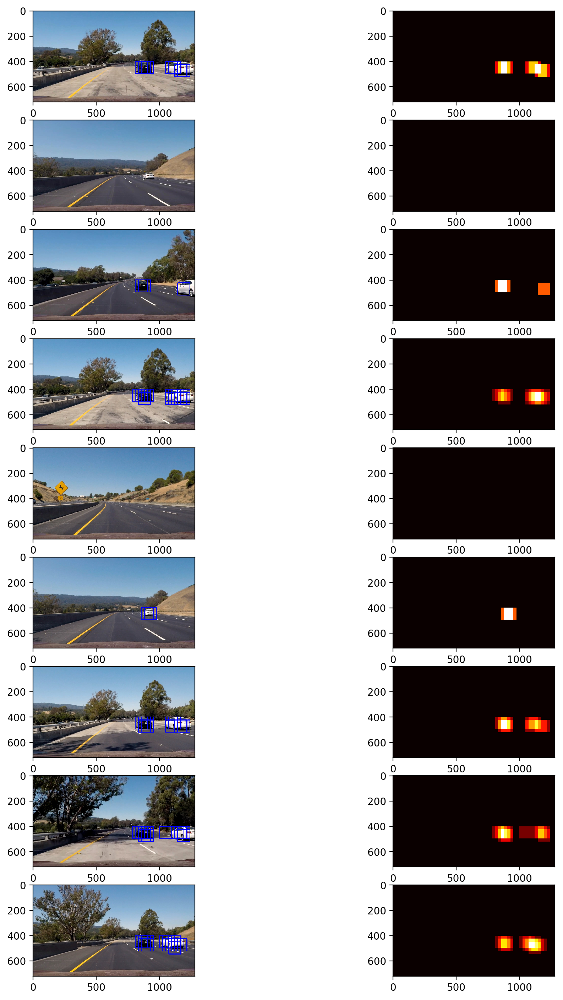

In [136]:
out_images = []
out_titles = []
scale = 1.5
y_start = 400
y_stop = 656
confidence_threshold = 0.01
for f in example_images: 
    img_boxes = []
    cnt = 0
    img = mpimg.imread(f)
    draw_img, heatmap, out_boxes = get_heatmap_and_decorated(img, scale = 1.5)
    #print(len(out_boxes))
    out_images.append(draw_img)
    out_images.append(heatmap)     
    out_titles.append("")
    out_titles.append("")                        
fig = plt.figure(figsize = (12,18), dpi = 200)
fig.tight_layout()
visualize_figure(fig, 9, 2, out_images, out_titles)

## Detections over previous frames

In [54]:
class Detection():
    def __init__(self, queue_length, heap_thr):
        self.all_detected_rects = []
        self.queue_length = queue_length
        self.heap_thr = heap_thr
        
    def put_boxes(self, boxes):
        self.all_detected_rects.append(boxes)
        if (len(self.all_detected_rects) > self.queue_length + 1) :
            self.all_detected_rects.pop(0)
            
    def get_accumulated_heatmap(self, img):
        heatmap = np.zeros_like(img[:,:,0])
        for rectangles in self.all_detected_rects:
            heatmap = add_heat(heatmap, rectangles)
        return apply_threshold(heatmap, self.heap_thr)
        
        

## Processing Pipeline

In [127]:

def process_image(img, detection):
    ## try 3 different scales
    color_space= 'YCrCb'#'RGB''LUV'HLS YUV YCrCb'
    orient = 9
    pix_per_cell = 8
    cell_per_block = 2
    hog_channel = 'ALL'
    spatial_size = (32,32)
    hist_bins = 32
    spatial = True
    hist = True
    hog = True
    boxes = []
    #heatmap_base = np.zeros_like(img[:,:,0])
    draw_img, heatmap, out_boxes0 = get_heatmap_and_decorated(img, scale = 1.5, cells_per_step = 2, y_start=400, y_stop=656,confidence_threshold = 0.46)
    draw_img, heatmap, out_boxes1 = get_heatmap_and_decorated(img, scale = 1.5, cells_per_step = 1, y_start=400, y_stop=500)
    draw_img, heatmap, out_boxes2 = get_heatmap_and_decorated(img, scale = 2, cells_per_step = 2, y_start=400, y_stop=600)
    draw_img, heatmap, out_boxes3 = get_heatmap_and_decorated(img, scale = 2.5, cells_per_step = 2, y_start=400, y_stop=656)
    draw_img, heatmap, out_boxes4 = get_heatmap_and_decorated(img, scale = 1.0, cells_per_step = 2, y_start=400, y_stop=656,confidence_threshold = 0.46)
    draw_img, heatmap, out_boxes5 = get_heatmap_and_decorated(img, scale = 0.7, confidence_threshold = 0.1 )
    #print('0',len(out_boxes0))
    #print('1',len(out_boxes1))
    #print('2', len(out_boxes2))
    #print('3',len(out_boxes3))
    boxes.extend(out_boxes0)
    boxes.extend(out_boxes1)
    #print('out_boxes1',out_boxes1)
    #print('out_boxes2',out_boxes2)
    boxes.extend(out_boxes2)
    boxes.extend(out_boxes3)
    boxes.extend(out_boxes4)
    boxes.extend(out_boxes5)
    detection.put_boxes(boxes)
    heatmap = detection.get_accumulated_heatmap(img)
    labels = label(heatmap)
    draw_img = draw_labeled_boxes(np.copy(img), labels)
    return draw_img
    

## Try out on test examples

test_images/challenge_1.jpg


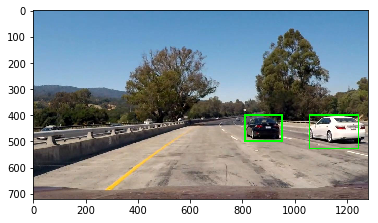

test_images/challenge_2.jpg


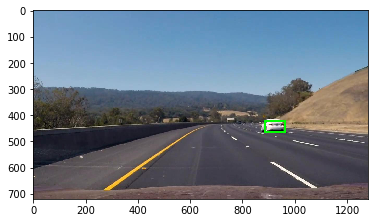

test_images/challenge_3.jpg


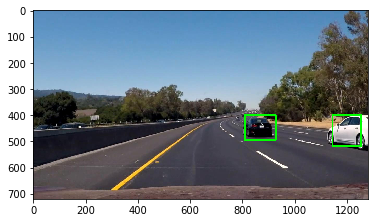

test_images/test1.jpg


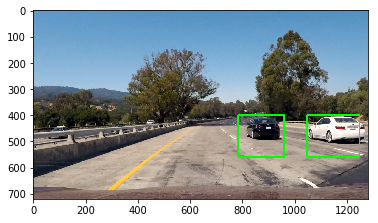

test_images/test2.jpg


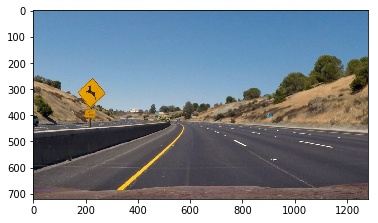

test_images/test3.jpg


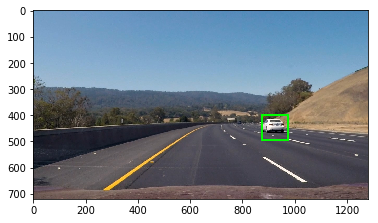

test_images/test4.jpg


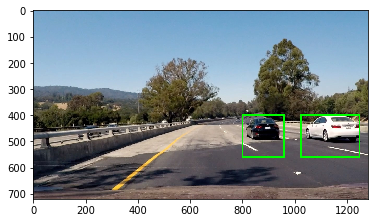

test_images/test5.jpg


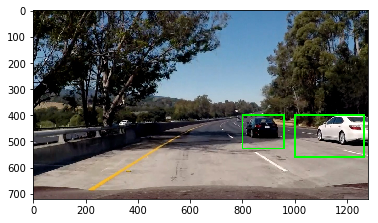

test_images/test6.jpg


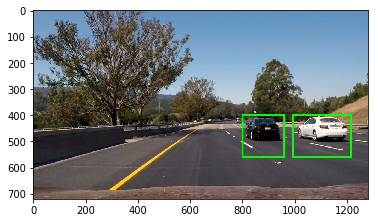

In [129]:
#print(len(example_images))

for f in example_images: 
    img = mpimg.imread(f)
    detection = Detection(3, 0)
    decorated = process_image(img, detection)
    print(f)
    plt.imshow(decorated)
    plt.show()

## Writing video

In [134]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

detection = Detection(8, 12.5)
output_video = 'output.mp4'
#clip = VideoFileClip('test_video.mp4')
clip = VideoFileClip('project_video.mp4')
result_video = clip.fl_image(lambda x: process_image(x, detection))
%time result_video.write_videofile(output_video, audio=False)

[MoviePy] >>>> Building video output.mp4
[MoviePy] Writing video output.mp4


100%|█████████▉| 1260/1261 [58:30<00:02,  2.79s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output.mp4 

CPU times: user 1h 38min 33s, sys: 3min 33s, total: 1h 42min 7s
Wall time: 58min 32s


In [ ]:
##Debugging, creating new testing images
challenge_name = 'test_images/challenge_3.jpg'
clip.save_frame(challenge_name, t=44)
challenge_img = mpimg.imread(challenge_name)
plt.imshow(challenge_img)
search_path = 'test_images/*'
example_images = glob.glob(search_path)